In [1]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, classification_report
import matplotlib.pyplot as plt
from sklearn import tree
import seaborn as sns
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 1000
sns.set_theme(style='darkgrid', palette='rainbow')
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
df = pd.read_csv("Company_Data.csv")

In [3]:
df

,Sales,CompPrice,Income,Advertising,Population,Price,ShelveLoc,Age,Education,Urban,US
0,9.50,138,73,11,276,120,Bad,42,17,Yes,Yes
1,11.22,111,48,16,260,83,Good,65,10,Yes,Yes
2,10.06,113,35,10,269,80,Medium,59,12,Yes,Yes
3,7.40,117,100,4,466,97,Medium,55,14,Yes,Yes
4,4.15,141,64,3,340,128,Bad,38,13,Yes,No
...,...,...,...,...,...,...,...,...,...,...,...
395,12.57,138,108,17,203,128,Good,33,14,Yes,Yes
396,6.14,139,23,3,37,120,Medium,55,11,No,Yes
397,7.41,162,26,12,368,159,Medium,40,18,Yes,Yes
398,5.94,100,79,7,284,95,Bad,50,12,Yes,Yes


In [4]:
df.describe()

,Sales,CompPrice,Income,Advertising,Population,Price,Age,Education
count,400.000000,400.000000,400.000000,400.000000,400.000000,400.000000,400.000000,400.000000
mean,7.496325,124.975000,68.657500,6.635000,264.840000,115.795000,53.322500,13.900000
std,2.824115,15.334512,27.986037,6.650364,147.376436,23.676664,16.200297,2.620528
min,0.000000,77.000000,21.000000,0.000000,10.000000,24.000000,25.000000,10.000000
25%,5.390000,115.000000,42.750000,0.000000,139.000000,100.000000,39.750000,12.000000
50%,7.490000,125.000000,69.000000,5.000000,272.000000,117.000000,54.500000,14.000000
75%,9.320000,135.000000,91.000000,12.000000,398.500000,131.000000,66.000000,16.000000
max,16.270000,175.000000,120.000000,29.000000,509.000000,191.000000,80.000000,18.000000


# EDA

In [5]:
df.isnull().sum()

Sales          0
CompPrice      0
Income         0
Advertising    0
Population     0
Price          0
ShelveLoc      0
Age            0
Education      0
Urban          0
US             0
dtype: int64

<Axes: >

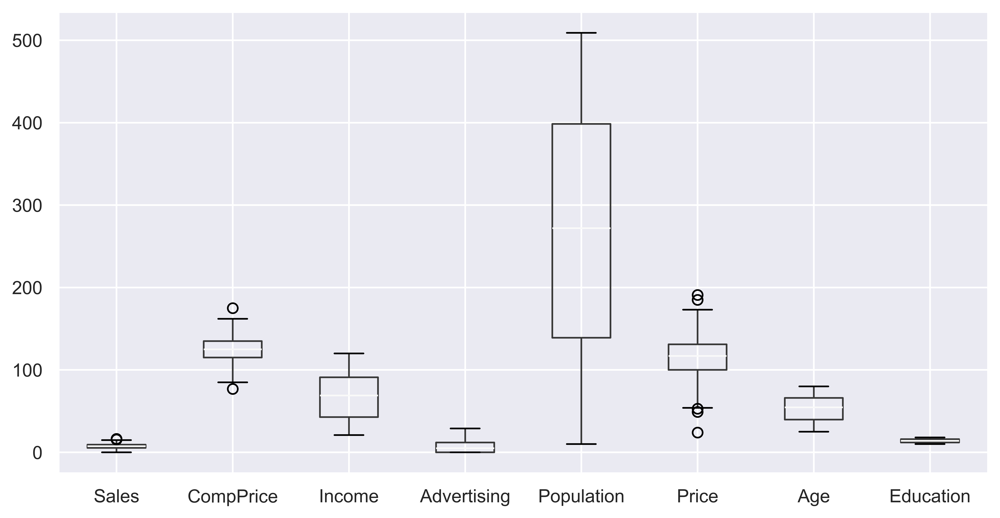

In [6]:
df.boxplot()

In [7]:
def outlier_replace(df, col):
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5*IQR
    upper_bound = Q3 + 1.5*IQR

    df[col] = df[col].apply(lambda x: upper_bound if x > upper_bound else (lower_bound if x < lower_bound else x))

    return df

In [8]:
df = outlier_replace(df, 'Sales')
df = outlier_replace(df, 'CompPrice')
df = outlier_replace(df, 'Income')
df = outlier_replace(df, 'Advertising')
df = outlier_replace(df, 'Population')
df = outlier_replace(df, 'Price')
df = outlier_replace(df, 'Age')
df = outlier_replace(df, 'Education')

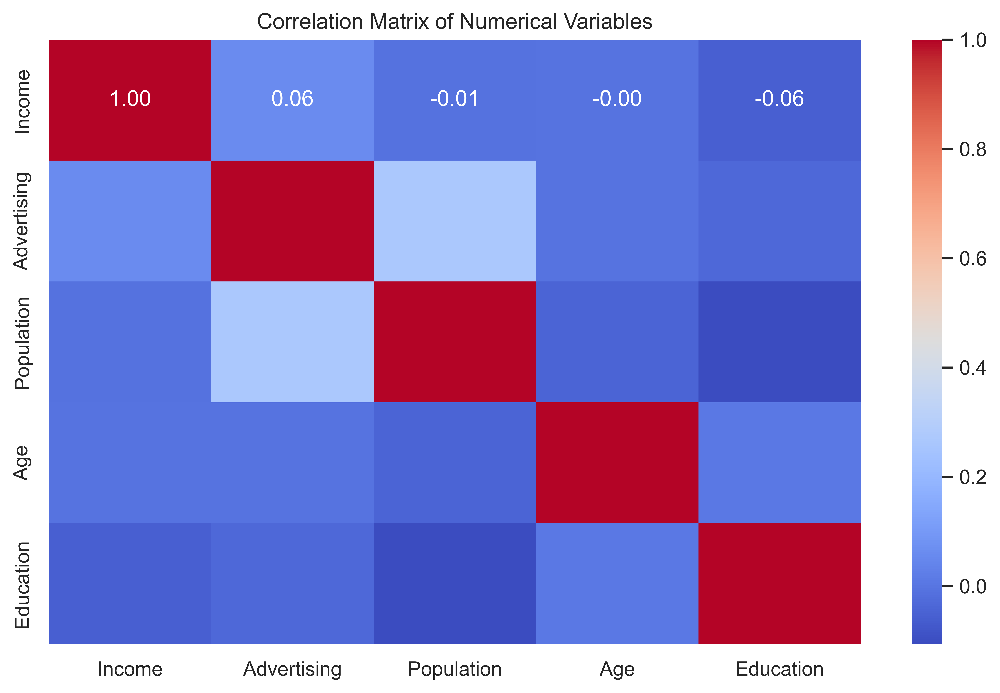

In [9]:
numerical_features = df.select_dtypes(int).columns
plt.figure(figsize=(10, 6))
sns.heatmap(df[numerical_features].corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Numerical Variables')
plt.show()

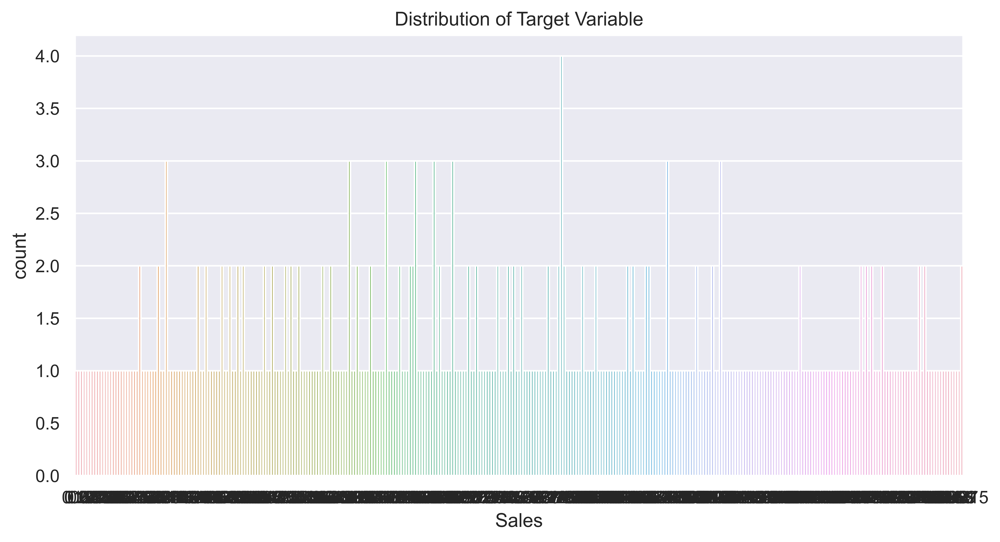

In [10]:
sns.countplot(x='Sales', data=df)
plt.title('Distribution of Target Variable')
plt.show()


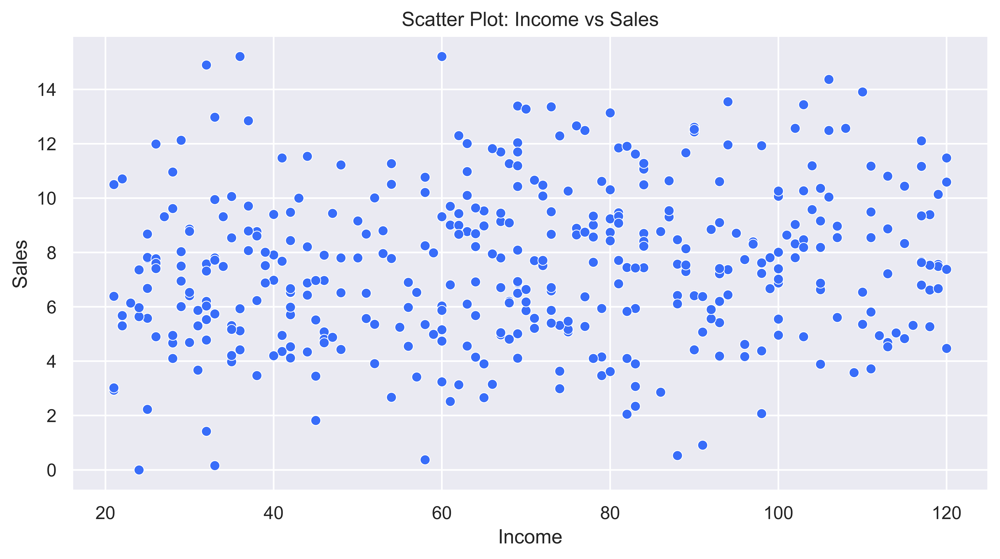

In [11]:
sns.scatterplot(x='Income', y='Sales', data=df)
plt.title('Scatter Plot: Income vs Sales')
plt.xlabel('Income')
plt.ylabel('Sales')
plt.show()

In [12]:
sns.pairplot(df)
plt.show()

In [13]:
df['Sales'].unique()

array([ 9.5  , 11.22 , 10.06 ,  7.4  ,  4.15 , 10.81 ,  6.63 , 11.85 ,
        6.54 ,  4.69 ,  9.01 , 11.96 ,  3.98 , 10.96 , 11.17 ,  8.71 ,
        7.58 , 12.29 , 13.91 ,  8.73 ,  6.41 , 12.13 ,  5.08 ,  5.87 ,
       10.14 , 14.9  ,  8.33 ,  5.27 ,  2.99 ,  7.81 , 13.55 ,  8.25 ,
        6.2  ,  8.77 ,  2.67 , 11.07 ,  8.89 ,  4.95 ,  6.59 ,  3.24 ,
        2.07 ,  7.96 , 10.43 ,  4.12 ,  4.16 ,  4.56 , 12.44 ,  4.38 ,
        3.91 , 10.61 ,  1.42 ,  4.42 ,  7.91 ,  6.92 ,  4.9  ,  6.85 ,
       11.91 ,  0.91 ,  5.42 ,  5.21 ,  8.32 ,  7.32 ,  1.82 ,  8.47 ,
        7.8  ,  8.85 , 13.39 ,  7.99 ,  9.46 ,  6.5  ,  5.52 , 12.61 ,
        8.55 , 10.64 ,  7.7  ,  4.43 ,  9.14 ,  8.01 ,  7.52 , 11.62 ,
        2.23 ,  8.7  , 11.7  ,  6.56 ,  7.95 ,  5.33 ,  4.81 ,  4.53 ,
        8.86 ,  8.39 ,  5.58 ,  9.48 ,  7.45 , 12.49 ,  4.88 ,  4.11 ,
        5.3  ,  5.07 ,  4.62 ,  5.55 ,  0.16 ,  3.47 ,  8.98 ,  9.   ,
        6.62 ,  6.67 ,  6.01 ,  9.31 ,  8.54 ,  8.8  ,  7.57 ,  7.37 ,
      

In [14]:
df.dtypes

Sales          float64
CompPrice      float64
Income           int64
Advertising      int64
Population       int64
Price          float64
ShelveLoc       object
Age              int64
Education        int64
Urban           object
US              object
dtype: object

In [15]:
df['Sales']=df['Sales'].astype(int)

In [16]:
df['Sales'].unique()

array([ 9, 11, 10,  7,  4,  6,  3,  8, 12, 13,  5, 14,  2,  1,  0, 15])

In [17]:
j = 0
for i in df['Sales']:
    if i <= 5:
        df['Sales'][j] = 'Very low'
    elif (i > 5) & (i <= 10):
       df['Sales'][j] = 'low'
    elif (i > 10) & (i <= 15):
         df['Sales'][j] = 'High'
    else:
        df['Sales'][j] = 'Very High'
    j = j + 1

In [18]:
df

,Sales,CompPrice,Income,Advertising,Population,Price,ShelveLoc,Age,Education,Urban,US
0,low,138.0,73,11,276,120.0,Bad,42,17,Yes,Yes
1,High,111.0,48,16,260,83.0,Good,65,10,Yes,Yes
2,low,113.0,35,10,269,80.0,Medium,59,12,Yes,Yes
3,low,117.0,100,4,466,97.0,Medium,55,14,Yes,Yes
4,Very low,141.0,64,3,340,128.0,Bad,38,13,Yes,No
...,...,...,...,...,...,...,...,...,...,...,...
395,High,138.0,108,17,203,128.0,Good,33,14,Yes,Yes
396,low,139.0,23,3,37,120.0,Medium,55,11,No,Yes
397,low,162.0,26,12,368,159.0,Medium,40,18,Yes,Yes
398,Very low,100.0,79,7,284,95.0,Bad,50,12,Yes,Yes


In [19]:
df['ShelveLoc'].unique()

array(['Bad', 'Good', 'Medium'], dtype=object)

In [20]:
df['ShelveLoc'] = df['ShelveLoc'].replace(['Bad', 'Good', 'Medium'],[0,1,2])

In [21]:
df['ShelveLoc'] 

0      0
1      1
2      2
3      2
4      0
      ..
395    1
396    2
397    2
398    0
399    1
Name: ShelveLoc, Length: 400, dtype: int64

In [22]:
df[['Urban','US' ]] = df[['Urban','US' ]].replace(['Yes','No'], [1,0])

In [23]:
df[['Urban','US' ]]

,Urban,US
0,1,1
1,1,1
2,1,1
3,1,1
4,1,0
...,...,...
395,1,1
396,0,1
397,1,1
398,1,1


In [24]:
df

,Sales,CompPrice,Income,Advertising,Population,Price,ShelveLoc,Age,Education,Urban,US
0,low,138.0,73,11,276,120.0,0,42,17,1,1
1,High,111.0,48,16,260,83.0,1,65,10,1,1
2,low,113.0,35,10,269,80.0,2,59,12,1,1
3,low,117.0,100,4,466,97.0,2,55,14,1,1
4,Very low,141.0,64,3,340,128.0,0,38,13,1,0
...,...,...,...,...,...,...,...,...,...,...,...
395,High,138.0,108,17,203,128.0,1,33,14,1,1
396,low,139.0,23,3,37,120.0,2,55,11,0,1
397,low,162.0,26,12,368,159.0,2,40,18,1,1
398,Very low,100.0,79,7,284,95.0,0,50,12,1,1


In [25]:
# data = pd.DataFrame({'X' : [ 9.5 , 11.22, 10.06,  7.4 ,  4.15, 10.81]})

In [26]:
# data['X']=data['X'].astype(int)

In [27]:
# data

In [28]:
# j = 0
# # for i in data['X']:
#     if i <= 5:
#         data['X'][j] = 'Very low'
#     elif (i > 5) & (i <= 10):
#        data['X'][j] = 'low'
#     elif (i > 10) & (i <= 15):
#          data['X'][j] = 'High'
#     else:
#         data['X'][j] = 'Very High'
#     j = j + 1

In [29]:
# data

In [30]:
X = df.iloc[:, 1:]
y = df['Sales']

In [31]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state =42)

In [32]:
X_test

,CompPrice,Income,Advertising,Population,Price,ShelveLoc,Age,Education,Urban,US
209,98.0,21,11,326,90.0,0,76,11,0,1
280,121.0,86,10,496,145.0,0,51,10,1,1
33,114.0,38,13,317,128.0,1,50,16,1,1
210,125.0,41,2,357,123.0,0,47,14,0,1
93,145.0,30,0,67,104.0,2,55,17,1,0
...,...,...,...,...,...,...,...,...,...,...
246,120.0,56,20,266,90.0,0,78,18,1,1
227,113.0,64,10,68,101.0,2,57,16,1,1
369,135.0,100,22,463,122.0,2,36,14,1,1
176,138.0,107,9,480,154.0,2,47,11,0,1


# model building

In [33]:
rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
yp = rfc.predict(X_test)


In [34]:
yp

array(['Very low', 'Very low', 'low', 'Very low', 'low', 'Very low',
       'low', 'low', 'low', 'low', 'Very low', 'low', 'low', 'low', 'low',
       'low', 'low', 'High', 'low', 'low', 'low', 'Very low', 'low',
       'Very low', 'Very low', 'Very low', 'low', 'low', 'low',
       'Very low', 'low', 'low', 'low', 'Very low', 'low', 'Very low',
       'Very low', 'low', 'low', 'Very low', 'Very low', 'Very low',
       'low', 'low', 'low', 'low', 'low', 'low', 'Very low', 'low', 'low',
       'low', 'Very low', 'low', 'low', 'Very low', 'low', 'low', 'High',
       'low', 'low', 'low', 'Very low', 'Very low', 'low', 'low', 'low',
       'low', 'Very low', 'low', 'low', 'low', 'low', 'Very low', 'low',
       'low', 'low', 'low', 'low', 'low'], dtype=object)

In [35]:
print(classification_report(y_test,yp))

              precision    recall  f1-score   support

        High       1.00      0.13      0.24        15
    Very low       0.70      0.70      0.70        23
         low       0.64      0.83      0.72        42

    accuracy                           0.66        80
   macro avg       0.78      0.55      0.55        80
weighted avg       0.72      0.66      0.62        80



In [36]:
rfc.score(X_train, y_train), rfc.score(X_test, y_test)

(1.0, 0.6625)

In [37]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

In [38]:
param_dist = {
    'n_estimators': randint(100, 1000),
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': randint(5, 50),
    'min_samples_split': randint(2, 20),
    'min_samples_leaf': randint(1, 10),
    'bootstrap': [True, False]
}

In [ ]:
random_search = RandomizedSearchCV(
    rfc, param_distributions=param_dist, n_iter=100, cv=5, scoring='accuracy', random_state=42
)

random_search.fit(X_train, y_train)

In [ ]:
best_params = random_search.best_params_
best_estimator = random_search.best_estimator_

In [ ]:
test_accuracy = best_estimator.score(X_test, y_test)

In [ ]:
final_model = RandomForestClassifier(**best_params)
final_model.fit(X, y)

In [ ]:
rfc =RandomForestClassifier(max_depth=46, max_features='log2', min_samples_leaf=3,
                       min_samples_split=13, n_estimators=666)
rfc.fit(X_train, y_train)
yp = rfc.predict(X_test)


In [ ]:
rfc.score(X_train, y_train), rfc.score(X_test, y_test)